In [ ]:
!pip install ydata_profiling

##Module 3: Classification

Imports:

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid", palette="bright")
import ydata_profiling
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_auc_score, precision_recall_curve, roc_curve, auc, f1_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

####Data loading:

In [ ]:
data = pd.read_csv("/content/weatherAUS.csv")
data.shape

(145460, 23)

In [ ]:
data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


Ratio of non-missing values in every column:

In [ ]:
data.count() / data.shape[0]

,0
Date,1.000000
Location,1.000000
MinTemp,0.989791
MaxTemp,0.991331
Rainfall,0.977581
Evaporation,0.568335
Sunshine,0.519902
WindGustDir,0.929011
WindGustSpeed,0.929445
WindDir9am,0.927361


In [ ]:
profile = ydata_profiling.ProfileReport(data)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##Data preparation

In [ ]:
data.drop(['Evaporation','Sunshine','Cloud9am','Cloud3pm'], axis = 1, inplace = True)

####Parse Date

In [ ]:
data.Date = pd.to_datetime(data['Date'])

In [ ]:
data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No


Now let's see if there were some 'bad days', that contain mostly missing values:

In [ ]:
print('Maximum number of missing values = number of columns in df = {}'.format(len(data.columns)))

Maximum number of missing values = number of columns in df = 19


Remove rows that have more than 10 missing values:

In [ ]:
bad_rows = data[data.shape[1] - data.count(axis=1) > 10].index
data.drop(bad_rows, axis = 0, inplace = True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 144347 entries, 0 to 145459
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Date           144347 non-null  datetime64[ns]
 1   Location       144347 non-null  object        
 2   MinTemp        143868 non-null  float64       
 3   MaxTemp        143945 non-null  float64       
 4   Rainfall       142017 non-null  float64       
 5   WindGustDir    134611 non-null  object        
 6   WindGustSpeed  134673 non-null  float64       
 7   WindDir9am     134416 non-null  object        
 8   WindDir3pm     140690 non-null  object        
 9   WindSpeed9am   143192 non-null  float64       
 10  WindSpeed3pm   141854 non-null  float64       
 11  Humidity9am    142757 non-null  float64       
 12  Humidity3pm    140851 non-null  float64       
 13  Pressure9am    130351 non-null  float64       
 14  Pressure3pm    130364 non-null  float64       
 15  Temp9

We wil remove missing values in target variable. We will remove those rows

In [ ]:
data.drop(data[data['RainTomorrow'].isnull()].index, axis = 0, inplace = True)

Final data shape:

In [ ]:
data.shape

(141949, 19)

##Train/Test split

In [ ]:
y = data["RainTomorrow"]
X = data.drop(columns=["RainTomorrow"])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

##Filling NA's

array([[<Axes: title={'center': 'Date'}>,
        <Axes: title={'center': 'MinTemp'}>,
        <Axes: title={'center': 'MaxTemp'}>,
        <Axes: title={'center': 'Rainfall'}>],
       [<Axes: title={'center': 'WindGustSpeed'}>,
        <Axes: title={'center': 'WindSpeed9am'}>,
        <Axes: title={'center': 'WindSpeed3pm'}>,
        <Axes: title={'center': 'Humidity9am'}>],
       [<Axes: title={'center': 'Humidity3pm'}>,
        <Axes: title={'center': 'Pressure9am'}>,
        <Axes: title={'center': 'Pressure3pm'}>,
        <Axes: title={'center': 'Temp9am'}>],
       [<Axes: title={'center': 'Temp3pm'}>, <Axes: >, <Axes: >,
        <Axes: >]], dtype=object)

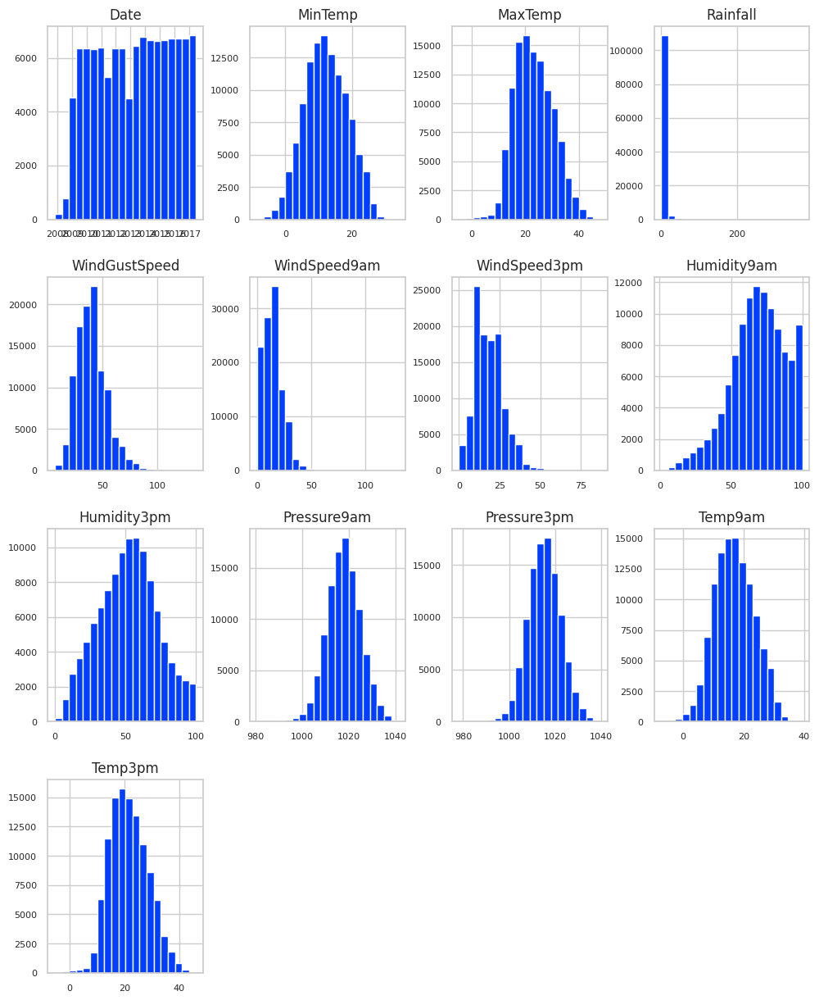

In [ ]:
X_train.hist(figsize=(12, 15), bins=20, xlabelsize=8, ylabelsize=8)

In [ ]:
X_train.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday
41000,2013-04-01,Williamtown,14.9,23.1,2.4,SE,28.0,W,ESE,9.0,20.0,87.0,68.0,1017.4,1015.8,17.5,22.6,Yes
18320,2009-07-25,NorahHead,7.7,19.0,0.2,N,33.0,NW,E,9.0,7.0,78.0,57.0,1025.8,1021.5,12.7,17.2,No
132310,2015-07-06,Hobart,4.8,8.1,0.0,S,33.0,SSW,SSW,19.0,17.0,68.0,64.0,1017.3,1017.8,5.7,7.1,No
32957,2015-12-11,Sydney,21.2,35.3,0.2,W,59.0,W,WNW,17.0,30.0,66.0,13.0,1005.8,1001.1,24.4,34.7,No
16091,2011-10-12,Newcastle,9.3,20.2,0.0,NaN,NaN,NaN,SE,0.0,6.0,71.0,52.0,NaN,NaN,15.8,20.0,No


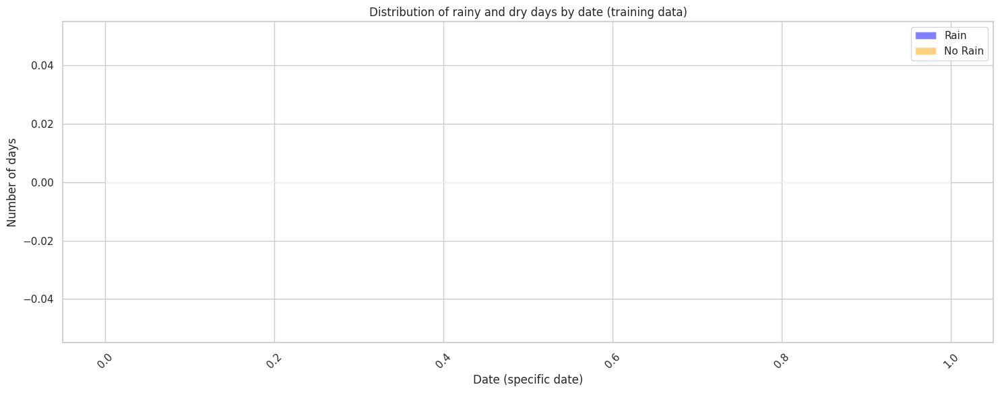

In [ ]:
train_data = X_train.copy()
train_data['RainTomorrow'] = y_train

train_data['Date'] = pd.to_datetime(train_data['Date'])

plt.figure(figsize=(15, 6))

train_data[train_data['RainTomorrow'] == 1 ]['Date'].hist(alpha=0.5, bins=30, label='Rain', color='blue')
train_data[train_data['RainTomorrow'] == 0 ]['Date'].hist(alpha=0.5, bins=30, label='No Rain', color='orange')

plt.xlabel('Date (specific date)')
plt.ylabel('Number of days')
plt.title('Distribution of rainy and dry days by date (training data)')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

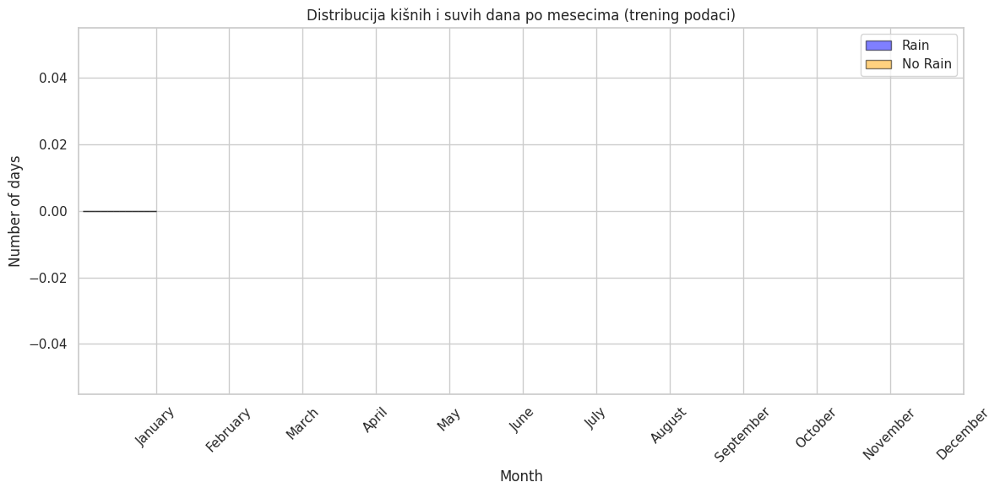

In [ ]:
train_data = X_train.copy()
train_data['RainTomorrow'] = y_train

train_data['Date'] = pd.to_datetime(train_data['Date'])

train_data['Month'] = train_data['Date'].dt.month

rain_data = train_data[train_data['RainTomorrow'] == 1 ]['Month']
no_rain_data = train_data[train_data['RainTomorrow'] == 0 ]['Month']

plt.figure(figsize=(12, 6))
plt.hist(rain_data, bins=12, alpha=0.5, label='Rain', color='blue', edgecolor='black')
plt.hist(no_rain_data, bins=12, alpha=0.5, label='No Rain', color='orange', edgecolor='black')

plt.xlabel('Month')
plt.ylabel('Number of days')
plt.title('Distribucija kišnih i suvih dana po mesecima (trening podaci)')
plt.xticks(range(1, 13), [
    'January', 'February', 'March', 'April', 'May', 'June',
    'July', 'August', 'September', 'October', 'November', 'December'
], rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
X_train = X_train.drop(columns=['Date'])
X_train = X_train.drop(columns=['Location'])
X_test = X_test.drop(columns=['Date'])
X_test = X_test.drop(columns=['Location'])

In [ ]:
numeric_columns = X_train.select_dtypes(include=['number']).columns
categorical_columns = X_train.select_dtypes(include=['object']).columns

X_train[numeric_columns] = X_train[numeric_columns].fillna(X_train[numeric_columns].median())
X_test[numeric_columns] = X_test[numeric_columns].fillna(X_train[numeric_columns].median())


X_train[categorical_columns] = X_train[categorical_columns].fillna(X_train[categorical_columns].mode().iloc[0])
X_test[categorical_columns] = X_test[categorical_columns].fillna(X_train[categorical_columns].mode().iloc[0])

# Data encoding for non-numeric values:

In [ ]:
X_train.head()

,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday
41000,14.9,23.1,2.4,SE,28.0,W,ESE,9.0,20.0,87.0,68.0,1017.4,1015.8,17.5,22.6,Yes
18320,7.7,19.0,0.2,N,33.0,NW,E,9.0,7.0,78.0,57.0,1025.8,1021.5,12.7,17.2,No
132310,4.8,8.1,0.0,S,33.0,SSW,SSW,19.0,17.0,68.0,64.0,1017.3,1017.8,5.7,7.1,No
32957,21.2,35.3,0.2,W,59.0,W,WNW,17.0,30.0,66.0,13.0,1005.8,1001.1,24.4,34.7,No
16091,9.3,20.2,0.0,W,39.0,N,SE,0.0,6.0,71.0,52.0,1017.6,1015.2,15.8,20.0,No


In [ ]:
categorical_columns = X_train.select_dtypes(include=['object']).columns.tolist()
print(categorical_columns)
# Primena one-hot encodinga na sve kategorijske kolone
y_train = y_train.map({'Yes': 1, 'No': 0})
X_train['RainToday'] = X_train['RainToday'].map({'Yes': 1, 'No': 0})

X_train = pd.get_dummies(X_train, columns=categorical_columns, drop_first=False)

y_test = y_test.map({'Yes': 1, 'No': 0})
X_test['RainToday'] = X_test['RainToday'].map({'Yes': 1, 'No': 0})

X_test = pd.get_dummies(X_test, columns=categorical_columns, drop_first=False)
X_test = X_test.reindex(columns=X_train.columns, fill_value=0)


pd.set_option('display.max_columns', None)

X_train.head()

['WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']


,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_E,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_0,RainToday_1
41000,14.9,23.1,2.4,28.0,9.0,20.0,87.0,68.0,1017.4,1015.8,17.5,22.6,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
18320,7.7,19.0,0.2,33.0,9.0,7.0,78.0,57.0,1025.8,1021.5,12.7,17.2,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
132310,4.8,8.1,0.0,33.0,19.0,17.0,68.0,64.0,1017.3,1017.8,5.7,7.1,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False
32957,21.2,35.3,0.2,59.0,17.0,30.0,66.0,13.0,1005.8,1001.1,24.4,34.7,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False
16091,9.3,20.2,0.0,39.0,0.0,6.0,71.0,52.0,1017.6,1015.2,15.8,20.0,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False


In [ ]:
boolean_columns = data.select_dtypes(include=['bool']).columns.tolist()
data[boolean_columns] = data[boolean_columns].astype(int)
pd.set_option('display.max_columns', None)  # Da bi se prikazale sve kolone
data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No


# Target analysis

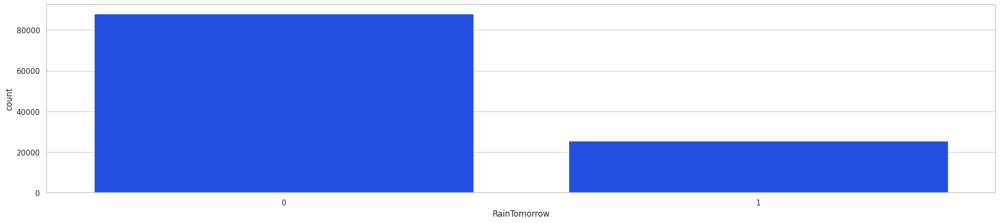

In [ ]:
y_train_df = y_train.to_frame(name='RainTomorrow')
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', data=y_train_df)
plt.show()

In [ ]:
X.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'WindGustDir',
       'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Temp9am', 'Temp3pm', 'RainToday'],
      dtype='object')

In [ ]:
X_train.head()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_E,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_0,RainToday_1
41000,14.9,23.1,2.4,28.0,9.0,20.0,87.0,68.0,1017.4,1015.8,17.5,22.6,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
18320,7.7,19.0,0.2,33.0,9.0,7.0,78.0,57.0,1025.8,1021.5,12.7,17.2,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
132310,4.8,8.1,0.0,33.0,19.0,17.0,68.0,64.0,1017.3,1017.8,5.7,7.1,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False
32957,21.2,35.3,0.2,59.0,17.0,30.0,66.0,13.0,1005.8,1001.1,24.4,34.7,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False
16091,9.3,20.2,0.0,39.0,0.0,6.0,71.0,52.0,1017.6,1015.2,15.8,20.0,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False


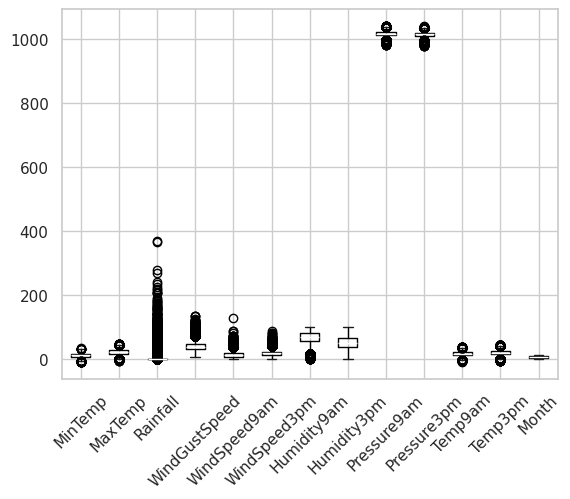

In [ ]:
train_data.boxplot(rot = 45);

##Under-sampling

In [ ]:
rus = RandomUnderSampler(random_state=42)
X_train_undersampled, y_train_undersampled = rus.fit_resample(X_train, y_train)

##Over-sampling (SMOTE)

In [ ]:
X_train.head()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_E,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_0,RainToday_1
41000,14.9,23.1,2.4,28.0,9.0,20.0,87.0,68.0,1017.4,1015.8,17.5,22.6,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
18320,7.7,19.0,0.2,33.0,9.0,7.0,78.0,57.0,1025.8,1021.5,12.7,17.2,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
132310,4.8,8.1,0.0,33.0,19.0,17.0,68.0,64.0,1017.3,1017.8,5.7,7.1,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False
32957,21.2,35.3,0.2,59.0,17.0,30.0,66.0,13.0,1005.8,1001.1,24.4,34.7,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False
16091,9.3,20.2,0.0,39.0,0.0,6.0,71.0,52.0,1017.6,1015.2,15.8,20.0,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False


In [ ]:
smote = SMOTE(random_state=42)
X_train_oversampled, y_train_oversampled = smote.fit_resample(X_train, y_train)

Visualize distributions:

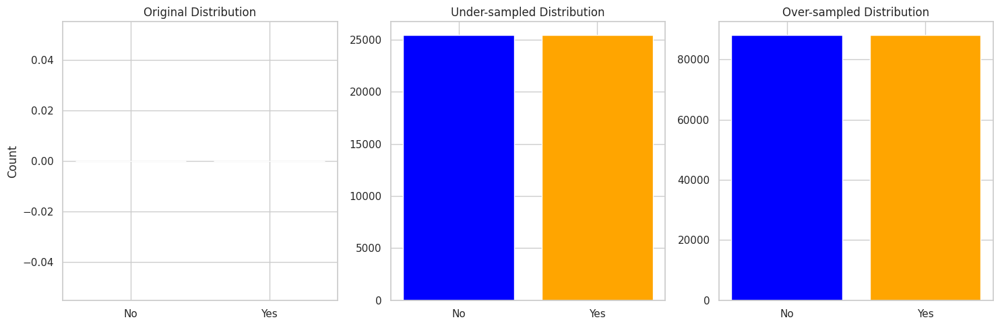

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

ax[0].bar(['No', 'Yes'], [sum(y == 0), sum(y == 1)], color=['blue', 'orange'])
ax[0].set_title('Original Distribution')
ax[0].set_ylabel('Count')

# Under-sampled distribution
ax[1].bar(['No', 'Yes'], [sum(y_train_undersampled == 0), sum(y_train_undersampled == 1)], color=['blue', 'orange'])
ax[1].set_title('Under-sampled Distribution')

# Over-sampled distribution
ax[2].bar(['No', 'Yes'], [sum(y_train_oversampled == 0), sum(y_train_oversampled == 1)], color=['blue', 'orange'])
ax[2].set_title('Over-sampled Distribution')

plt.tight_layout()
plt.show()


In [ ]:
print("Under-sampled Class Distribution:")
print(pd.Series(y_train_undersampled).value_counts())
print("Over-sampled Class Distribution:")
print(pd.Series(y_train_oversampled).value_counts())

Under-sampled Class Distribution:
RainTomorrow
0    25450
1    25450
Name: count, dtype: int64
Over-sampled Class Distribution:
RainTomorrow
1    88109
0    88109
Name: count, dtype: int64


##Logistic Regression

In [ ]:
log_reg = LogisticRegression(class_weight='balanced', random_state=42, max_iter=1000)
log_reg.fit(X_train, y_train)
y_pred = log_reg.predict(X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Evaluate performance:

In [ ]:
print("\nLogistic Regression with Class Weighting:")
print(classification_report(y_test, y_pred))
print("ROC-AUC Score:", roc_auc_score(y_test, log_reg.predict_proba(X_test)[:, 1]))


Logistic Regression with Class Weighting:
              precision    recall  f1-score   support

           0       0.92      0.79      0.85     22027
           1       0.51      0.75      0.60      6363

    accuracy                           0.78     28390
   macro avg       0.71      0.77      0.72     28390
weighted avg       0.82      0.78      0.79     28390

ROC-AUC Score: 0.8498066689844828


Feature importance:

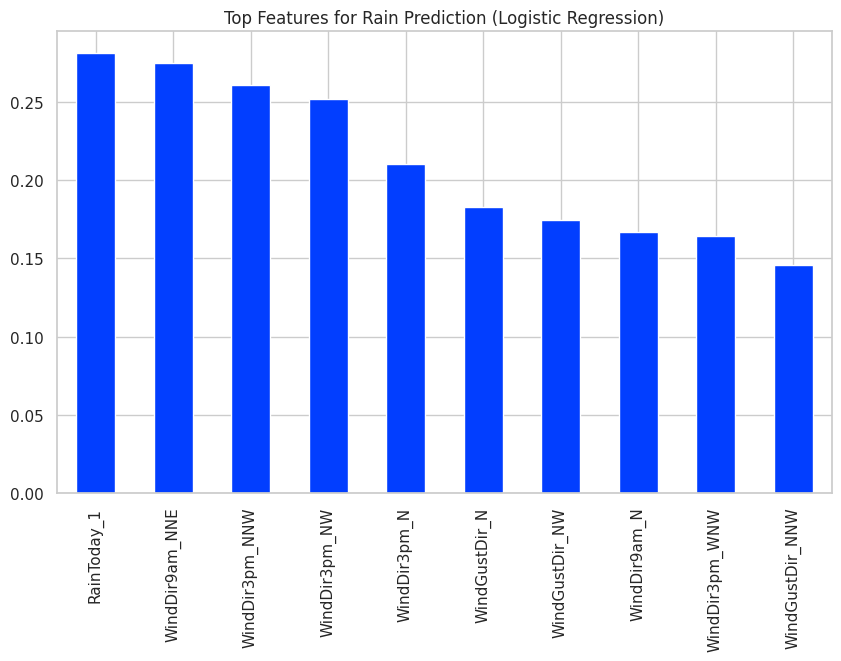

In [ ]:
coefficients = pd.Series(log_reg.coef_[0], index=X_train.columns).sort_values(ascending=False)

plt.figure(figsize=(10, 6))
coefficients.head(10).plot(kind='bar', title='Top Features for Rain Prediction (Logistic Regression)')
plt.show()

Threshold analysis:


Optimal Threshold: 0.63
Precision: 0.60, Recall: 0.63, F1-Score: 0.61


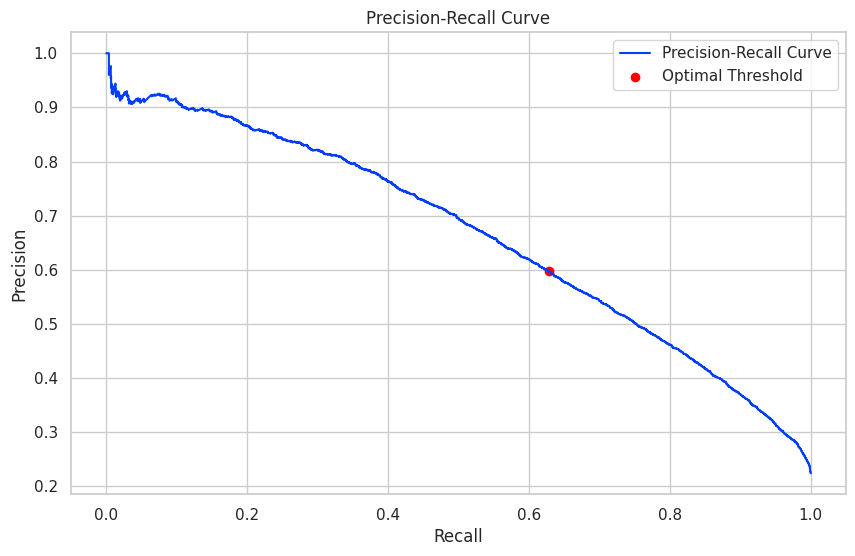

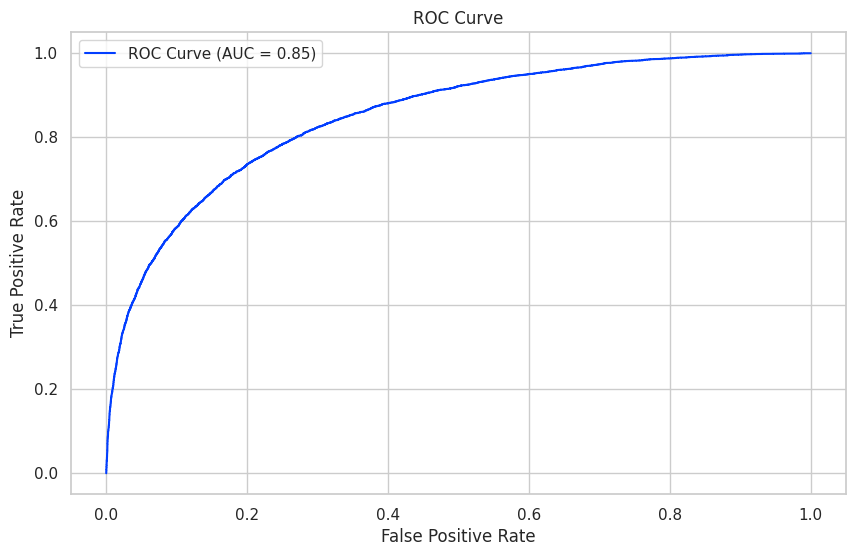


Classification Report with Optimal Threshold:
              precision    recall  f1-score   support

           0       0.89      0.88      0.88     22027
           1       0.60      0.63      0.61      6363

    accuracy                           0.82     28390
   macro avg       0.74      0.75      0.75     28390
weighted avg       0.83      0.82      0.82     28390



In [ ]:
y_proba = log_reg.predict_proba(X_test)[:, 1]

precision, recall, thresholds_pr = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * (precision * recall) / (precision + recall)

optimal_idx = f1_scores.argmax()
optimal_threshold = thresholds_pr[optimal_idx]

print(f"\nOptimal Threshold: {optimal_threshold:.2f}")
print(f"Precision: {precision[optimal_idx]:.2f}, Recall: {recall[optimal_idx]:.2f}, F1-Score: {f1_scores[optimal_idx]:.2f}")

plt.figure(figsize=(10, 6))
plt.plot(recall, precision, label="Precision-Recall Curve")
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label="Optimal Threshold")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve")
plt.legend()
plt.show()

fpr, tpr, thresholds_roc = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.show()

y_pred_optimal = (y_proba >= optimal_threshold).astype(int)

print("\nClassification Report with Optimal Threshold:")
print(classification_report(y_test, y_pred_optimal))

##K-Nearest Neighbouts

####Base model:

In [ ]:
n_neighbors = 15
metric = 'manhattan'

knn = KNeighborsClassifier(n_neighbors=n_neighbors, metric=metric)
knn.fit(X_train, y_train)

y_pred_knn = knn.predict(X_test)
y_prob_knn = knn.predict_proba(X_test)[:, 1]

Evaluate:

In [ ]:
print("KNN Base Model Evaluation:")
print(classification_report(y_test, y_pred_knn))
print("ROC-AUC Score:", roc_auc_score(y_test, y_prob_knn))

KNN Base Model Evaluation:
              precision    recall  f1-score   support

           0       0.86      0.95      0.91     22027
           1       0.74      0.47      0.58      6363

    accuracy                           0.85     28390
   macro avg       0.80      0.71      0.74     28390
weighted avg       0.84      0.85      0.83     28390

ROC-AUC Score: 0.8503567596640589


Impact of different K values:

In [ ]:
k_values = [9, 11, 13, 15, 17]
roc_auc_scores = []

for k in k_values:
    temp_knn = KNeighborsClassifier(n_neighbors=k, metric=metric)
    temp_knn.fit(X_train, y_train)
    temp_prob_knn = temp_knn.predict_proba(X_test)[:, 1]
    roc_auc_scores.append(roc_auc_score(y_test, temp_prob_knn))

# Grafikon
plt.plot(k_values, roc_auc_scores, marker='o', label='ROC-AUC')
plt.title("K vs ROC-AUC")
plt.xlabel("Number of Neighbors (K)")
plt.ylabel("ROC-AUC Score")
plt.legend()
plt.show()

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_prob_knn)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2, label='Random Chance')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve for KNN Model (n_neighbors={n_neighbors}, metric={metric})')
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()

####GridSearchCV model:

In [ ]:
knn = KNeighborsClassifier()
param_grid_knn = {'n_neighbors': [9,11,13,15,17], 'metric':('chebyshev', 'euclidean', 'manhattan')}
grid_knn = GridSearchCV(knn, param_grid_knn, cv=5, scoring='roc_auc', n_jobs=-1)
grid_knn.fit(X_train, y_train)
best_k = grid_knn.best_params_['n_neighbors']
print(f"Best K: {best_k}")
knn = grid_knn.best_estimator_
y_pred_knn = knn.predict(X_test)
y_prob_knn = knn.predict_proba(X_test)[:, 1]

Evaluate:

In [ ]:
print("KNN Evaluation:")
print(classification_report(y_test, y_pred_knn))
print("ROC-AUC Score:", roc_auc_score(y_test, y_prob_knn))

Impact od different K values:

In [ ]:
results = grid_knn.cv_results_
plt.plot(param_grid_knn['n_neighbors'], results['mean_test_score'], marker='o')
plt.title("K vs ROC-AUC")
plt.xlabel("Number of Neighbors (K)")
plt.ylabel("Mean ROC-AUC")
plt.show()

##Naive Bayes

In [ ]:
nb = GaussianNB()
nb.fit(X_train, y_train)
y_pred_nb = nb.predict(X_test)
y_prob_nb = nb.predict_proba(X_test)[:, 1]

Evaluate:

In [ ]:
print("Naive Bayes Evaluation:")
print(classification_report(y_test, y_pred_nb))
print("ROC-AUC Score:", roc_auc_score(y_test, y_prob_nb))

Naive Bayes Evaluation:
              precision    recall  f1-score   support

           0       0.87      0.75      0.81     22027
           1       0.42      0.61      0.49      6363

    accuracy                           0.72     28390
   macro avg       0.64      0.68      0.65     28390
weighted avg       0.77      0.72      0.74     28390

ROC-AUC Score: 0.7502736112419458


ROC-AUC visualization:

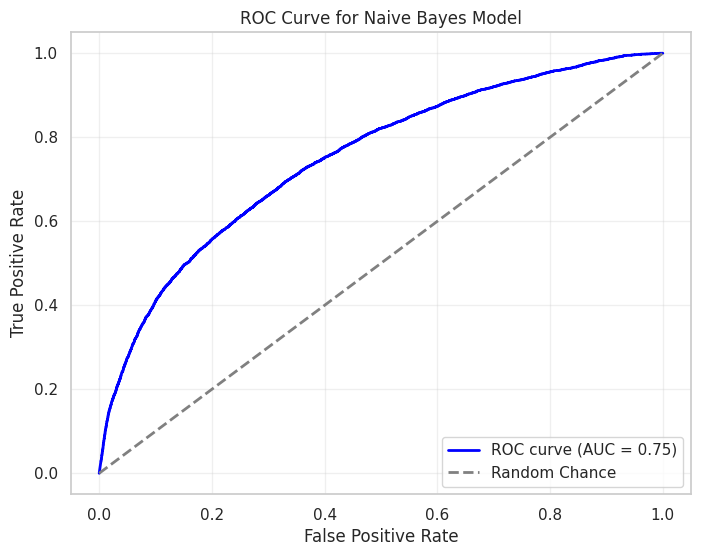

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_prob_nb)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2, label='Random Chance')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Naive Bayes Model')
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()

##Support Vector Machine (SVM)

####Baseline model:

In [ ]:
svm_baseline = SVC(probability=True, class_weight='balanced', random_state=42, C=1, kernel='rbf')

svm_baseline.fit(X_train, y_train)

y_pred_svm = svm_baseline.predict(X_test)
y_prob_svm = svm_baseline.predict_proba(X_test)[:, 1]

Evaluation:

In [ ]:
print("SVM Baseline Evaluation:")
print(classification_report(y_test, y_pred_svm))
print("ROC-AUC Score:", roc_auc_score(y_test, y_prob_svm))

ROC-AUC  visualization

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_prob_svm)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for SVM Baseline Model')
plt.legend(loc="lower right")
plt.show()

####GridSearchCV model:

In [ ]:
svm = SVC(probability=True, class_weight='balanced', random_state=42)
param_grid_svm = {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}
grid_svm = GridSearchCV(svm, param_grid_svm, cv=5, scoring='roc_auc', n_jobs=-1)
grid_svm.fit(X_train, y_train)
best_params_svm = grid_svm.best_params_
print(f"Best Parameters for SVM: {best_params_svm}")
svm = grid_svm.best_estimator_
y_pred_svm = svm.predict(X_test)
y_prob_svm = svm.predict_proba(X_test)[:, 1]


Evaluate:

In [ ]:
print("SVM Evaluation:")
print(classification_report(y_test, y_pred_svm))
print("ROC-AUC Score:", roc_auc_score(y_test, y_prob_svm))